### 공공 데이터 분석

서울 교통수단 이동데이터

1. 비즈니스 이해

언제, 어디서, 어느 구간에서 혼잡이 집중되는가?

출/퇴근 시간대 주요 병목 구간은 어디인가?

분석 목표 : 정류장 간 출/퇴근 시간대 혼잡도를 파악하여 혼잡 완화를 위한 인사이트 도출

---

2. 데이터 이해

| 파일명                                   | 데이터 의미                                      |
| ------------------------------------- | ----------------------------------------------- |
| DISTRICT\_EMD.csv                     | 행정동 코드와 명칭, 소속 구/시 데이터 |
| KSCC\_DV\_SUBWAY\_STATION\_GEOM.csv   | 지하철역 ID, 역명, 노선, 위치 데이터 |
| KSCC\_DX\_PATTERN\_STAT.csv           | 출근·퇴근·기타 등 패턴별, 날짜별·시간대별 통행량 데이터 |
| KSCC\_DX\_RA\_OD.csv                  | 정류장 간 OD(출발/도착) 통행량 데이터 |
| KSCC\_DX\_TRIP\_CHAIN\_SUM.csv        | 복합 이동 경로(환승) 요약 데이터 |
| KSCC\_DX\_TRNSF\_PATH\_SUM.csv        | 환승 구간/시간별 통계 데이터 |
| TBIS\_MS\_ROUTE.csv                   | 버스 노선 기본 데이터 |
| TBIS\_MS\_ROUTE\_NODE.csv             | 노선별 정류장 연결/순서 데이터 |
| ★ TBIS\_MS\_STTN.csv                    | 정류장 ID/명칭/위경도 데이터 |
| TB\_OPR\_STATION.csv                  | 운영 정류장 상세 주소와 좌표 데이터 |
| ★ TPSS\_A18\_ROUTE\_SECTION.csv         | 정류장 구간별, 시간대별 혼잡도(통행량) 데이터  |
| TPSS\_BCYCL\_OD\_STATN\_HM.csv        | 공유자전거 OD별 이용량 데이터 |
| TPSS\_EMD\_INFO\_H\_BUS.csv           | 행정동별 버스 시간대별 통계 데이터 |
| TPSS\_EMD\_INFO\_H\_PUBLIC.csv        | 행정동별 대중교통 전체 통계 데이터 |
| TPSS\_EMD\_INFO\_H\_SUBWAY.csv        | 행정동별 지하철 통계 데이터 |
| TPSS\_EMD\_OD\_H.csv                  | 동 간 시간대별 OD(출발/도착) 데이터 |
| TPSS\_EMD\_OD\_PS.csv                 | 동 간 일/누적 유동량 데이터 |
| TPSS\_EMD\_OD\_TC.csv                 | 구/동 명칭 기반 OD 데이터 |
| TPSS\_ROUTE\_SECTION\_SPEED\_H.csv    | 구간별 평균 속도와 시간별 데이터 |
| TPSS\_STA\_ROUTE\_INFO\_H\_PASNGR.csv | 정류장/노선별 시간대별 승차량 데이터 |
| TPSS\_STA\_ROUTE\_INFO\_H\_TURN.csv   | 회차지점(회차, 환승지점) 통계 데이터 |

In [1]:
import pandas as pd

df_TBIS = pd.read_csv("./STM_datasets/2025/202501/250101/TBIS_MS_STTN.csv")
df_TPSS = pd.read_csv("./STM_datasets/2025/202501/250101/TPSS_A18_ROUTE_SECTION.csv")

In [ ]:
# 정류장 데이터 정보
df_TBIS.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63633 entries, 0 to 63632
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   STTN_ID       63633 non-null  int64  
 1   STTN_NM       63633 non-null  object 
 2   STTN_TY       63633 non-null  object 
 3   STTN_NO       63628 non-null  float64
 4   CRDNT_X       63633 non-null  float64
 5   CRDNT_Y       63633 non-null  float64
 6   BIT_INSTL_AT  63633 non-null  object 
dtypes: float64(3), int64(1), object(3)
memory usage: 3.4+ MB


In [3]:
df_TBIS.head(3)

,STTN_ID,STTN_NM,STTN_TY,STTN_NO,CRDNT_X,CRDNT_Y,BIT_INSTL_AT
0,164000626,e편한세상 정문,일반차로,38624.0,126.614929,37.410124,미설치
1,164000627,송도파크레인동일하이빌,일반차로,38625.0,126.656706,37.402844,미설치
2,164000628,송도파크레인동일하이빌,일반차로,38626.0,126.656054,37.404317,미설치


In [4]:
# 혼잡도 데이터 정보
df_TPSS.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37671 entries, 0 to 37670
Data columns (total 30 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   STDR_DE       37671 non-null  int64
 1   ROUTE_ID      37671 non-null  int64
 2   FROM_STTN_ID  37671 non-null  int64
 3   TO_STTN_ID    37671 non-null  int64
 4   STTN_SN       37671 non-null  int64
 5   CNT           37671 non-null  int64
 6   CNT_00H       37671 non-null  int64
 7   CNT_01H       37671 non-null  int64
 8   CNT_02H       37671 non-null  int64
 9   CNT_03H       37671 non-null  int64
 10  CNT_04H       37671 non-null  int64
 11  CNT_05H       37671 non-null  int64
 12  CNT_06H       37671 non-null  int64
 13  CNT_07H       37671 non-null  int64
 14  CNT_08H       37671 non-null  int64
 15  CNT_09H       37671 non-null  int64
 16  CNT_10H       37671 non-null  int64
 17  CNT_11H       37671 non-null  int64
 18  CNT_12H       37671 non-null  int64
 19  CNT_13H       37671 non-n

In [5]:
df_TPSS.head(3)

,STDR_DE,ROUTE_ID,FROM_STTN_ID,TO_STTN_ID,STTN_SN,CNT,CNT_00H,CNT_01H,CNT_02H,CNT_03H,...,CNT_14H,CNT_15H,CNT_16H,CNT_17H,CNT_18H,CNT_19H,CNT_20H,CNT_21H,CNT_22H,CNT_23H
0,20250101,100100001,101000331,101000053,1,1122,0,0,0,0,...,141,153,89,87,63,45,27,11,2,0
1,20250101,100100001,101000053,101000054,2,1738,0,0,0,0,...,201,178,119,113,86,62,46,15,5,0
2,20250101,100100001,101000054,101000103,3,2745,0,0,0,0,...,331,259,228,173,122,117,58,29,10,0


In [6]:
import matplotlib.pyplot as plt

# 한글 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False 

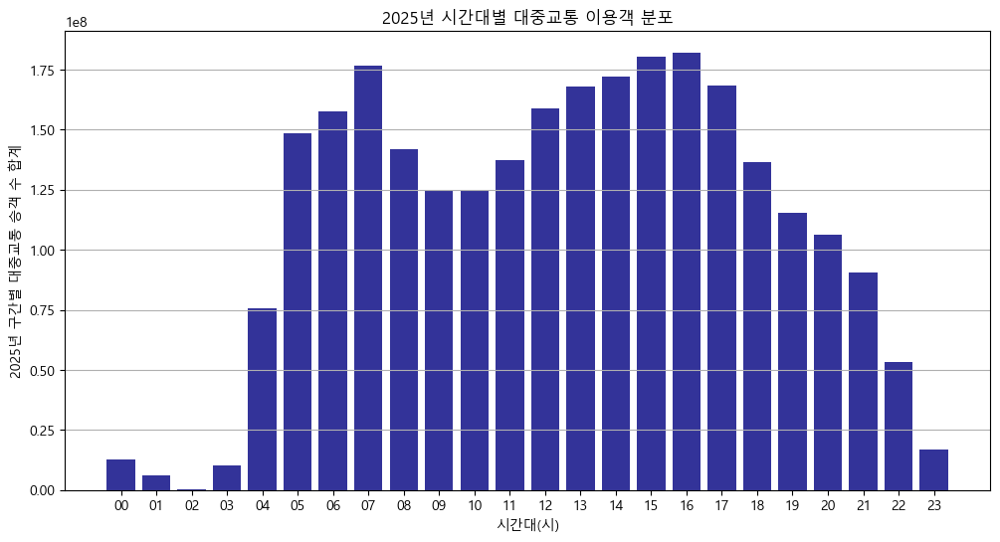

In [7]:
import os

dir_2025 = "C:/Users/asus/0528/STM_datasets/2025/"

route_list = []

# 혼잡도 데이터 읽어오기
for root, _, files in os.walk(dir_2025):
    for file in files:
        if file == "TPSS_A18_ROUTE_SECTION.csv":
            file_path = os.path.join(root, file)
            df = pd.read_csv(file_path, encoding="cp949")
            route_list.append(df)

# 2025년 모든 파일 누적 집계
df_all = pd.concat(route_list, ignore_index=True)

# 시간대 컬럼만 추출 (CNT_00H ~ CNT_23H)
hour_cols = [col for col in df_all.columns if col.startswith('CNT_') and col.endswith('H')]

# 시간대별 전체 승객 수 합산
hourly_sum = df_all[hour_cols].sum(axis=0)

# 시간대를 00~23시 정렬
hour_labels = [col.replace('CNT_','').replace('H','') for col in hour_cols]

plt.figure(figsize=(12,6))
plt.bar(hour_labels, hourly_sum, color='navy', alpha=0.8)
plt.xlabel("시간대(시)")
plt.ylabel("2025년 구간별 대중교통 승객 수 합계")
plt.title("2025년 시간대별 대중교통 이용객 분포")
plt.grid(axis='y')
plt.show()


3. 데이터 준비

##### utf-8로 인코딩 변경

In [4]:
import pandas as pd

# 변환할 최상위 폴더 경로 입력
base_dir = "C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/"

for root, _, files in os.walk(base_dir):
    for file in files:
        if file.endswith(".csv"):
            file_path = os.path.join(root, file)
            try:
                # utf-8로 먼저 읽기
                df = pd.read_csv(file_path, encoding='utf-8', on_bad_lines='skip')
            except Exception as e1:
                try:
                    # 안 되면 cp949로 읽기
                    df = pd.read_csv(file_path, encoding='cp949', on_bad_lines='skip')
                except Exception as e2:
                    print(f"❌ 변환 실패: {file_path}, 사유: {e1}, {e2}")
                    continue
            try:
                # utf-8-sig로 **덮어쓰기**
                df.to_csv(file_path, index=False, encoding='utf-8-sig')
                print(f"✅ 덮어쓰기 변환 완료: {file_path}")
            except Exception as e:
                print(f"❌ 저장 실패: {file_path}, 사유: {e}")


✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\DISTRICT_EMD.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DV_SUBWAY_STATION_GEOM.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_PATTERN_STAT.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_RA_OD.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_TRIP_CHAIN_SUM.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_TRNSF_PATH_SUM.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TBIS_MS_ROUTE.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TBIS_MS_ROUTE_NODE.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TBIS_MS_STTN.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TB_OPR

In [2]:
import os

# TB_OPR_STATION.csv 파일 인코딩 변경오류 발생
# csv 마지막줄 " 추가로 오류 해결

base_dir = "C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/"

for root, _, files in os.walk(base_dir):
    for file in files:
        if file == "TB_OPR_STATION.csv":
            file_path = os.path.join(root, file)
            try:
                with open(file_path, "r", encoding="cp949", errors="replace") as f:
                    lines = f.readlines()
            except Exception as e:
                print(f"❌ 파일 열기 실패: {file_path}, 사유: {e}")
                continue

            if not lines[-1].rstrip().endswith('"'):
                lines[-1] = lines[-1].rstrip("\r\n") + '"\n'
                
                try:
                    with open(file_path, "w", encoding="utf-8", errors="replace") as f:
                        f.writelines(lines)
                    print(f'✅ 마지막 줄에 " 추가 완료: {file_path}')
                except Exception as e:
                    print(f'❌ 파일 저장 실패: {file_path}, 사유: {e}')
            else:
                print(f'⭕ 이미 정상: {file_path}')


✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250102\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250103\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250104\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250105\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250106\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250107\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250108\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250109\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250110

##### 히트맵 출력을 위한 STTN_ID 기준으로 병합

In [5]:
base_dir = "C:/Users/asus/0528/STM_datasets/2025/"

for month in os.listdir(base_dir):
    month_path = os.path.join(base_dir, month)
    if not os.path.isdir(month_path): continue
    for day in os.listdir(month_path):
        day_path = os.path.join(month_path, day)
        if not os.path.isdir(day_path): continue

        sttn_path = os.path.join(day_path, "TBIS_MS_STTN.csv")
        cnt_path = os.path.join(day_path, "TPSS_STA_ROUTE_INFO_H_PASNGR.csv")
        output_path = os.path.join(day_path, "TBIS_TPSS_merge.csv")

        if os.path.isfile(sttn_path) and os.path.isfile(cnt_path):
            try:
                # utf-8로 읽기 (안 되면 cp949)
                try:
                    loc_df = pd.read_csv(sttn_path, encoding='utf-8')
                except Exception:
                    loc_df = pd.read_csv(sttn_path, encoding='cp949')
                try:
                    cnt_df = pd.read_csv(cnt_path, encoding='utf-8')
                except Exception:
                    cnt_df = pd.read_csv(cnt_path, encoding='cp949')

                # 컬럼명 정규화
                loc_df.columns = [c.upper().replace(" ", "").replace("-", "_") for c in loc_df.columns]
                cnt_df.columns = [c.upper().replace(" ", "").replace("-", "_") for c in cnt_df.columns]

                loc_cols = ['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y']
                cnt_cols = ['STTN_ID', 'CNT']
                if all(col in loc_df.columns for col in loc_cols) and all(col in cnt_df.columns for col in cnt_cols):
                    loc_df = loc_df[loc_cols]
                    cnt_df = cnt_df[cnt_cols]

                    # 병합 (STTN_ID 기준)
                    merged = pd.merge(loc_df, cnt_df, on='STTN_ID')
                    merged.dropna(subset=['CRDNT_X', 'CRDNT_Y', 'CNT'], inplace=True)
                    merged.to_csv(output_path, index=False, encoding='utf-8')
                    print(f"✅ [{day_path}] 병합 성공 (기준: STTN_ID, 행: {len(merged)})")
                else:
                    print(f"⚠️ [{day_path}] 컬럼 부족 또는 불일치")
            except Exception as e:
                print(f"❌ [{day_path}] 병합 실패: {e}")
        else:
            print(f"❌ [{day_path}] 위치 or 이용량 파일 없음")


✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250101] 병합 성공 (기준: STTN_ID, 행: 90077)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250102] 병합 성공 (기준: STTN_ID, 행: 91750)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250103] 병합 성공 (기준: STTN_ID, 행: 92199)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250104] 병합 성공 (기준: STTN_ID, 행: 90584)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250105] 병합 성공 (기준: STTN_ID, 행: 90844)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250106] 병합 성공 (기준: STTN_ID, 행: 91183)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250107] 병합 성공 (기준: STTN_ID, 행: 91675)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250108] 병합 성공 (기준: STTN_ID, 행: 91162)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250109] 병합 성공 (기준: STTN_ID, 행: 85654)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250110] 병합 성공 (기준: STTN_ID, 행: 87480)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250111] 병합 성공 (기준: STTN_ID, 행: 79605)
✅ [C:/Users/asus/0528/STM_datasets/2025/202501\250112] 병합 성공 (기준:

In [10]:
import folium
import numpy as np

base_dir = "C:/Users/asus/0528/STM_datasets/2025/"

route_list = []
sttn_info = None

for root, _, files in os.walk(base_dir):
    for file in files:
        if file == "TPSS_A18_ROUTE_SECTION.csv":
            file_path = os.path.join(root, file)
            try:
                df = pd.read_csv(file_path, encoding="utf-8")
            except Exception:
                df = pd.read_csv(file_path, encoding="cp949")
            df['MORNING'] = df[['CNT_07H', 'CNT_08H', 'CNT_09H']].sum(axis=1)
            route_list.append(df[['FROM_STTN_ID', 'TO_STTN_ID', 'MORNING'] + [col for col in df.columns if col.startswith('CNT_')]])
        if sttn_info is None and file == "TBIS_MS_STTN.csv":
            file_path = os.path.join(root, file)
            try:
                sttn_info = pd.read_csv(file_path, encoding="utf-8")
            except Exception:
                sttn_info = pd.read_csv(file_path, encoding="cp949")

if not route_list or sttn_info is None:
    print("[2025] 유효한 데이터 없음")
else:
    # 누적 집계
    route_df = pd.concat(route_list, ignore_index=True).groupby(['FROM_STTN_ID', 'TO_STTN_ID']).sum(numeric_only=True).reset_index()

    # 정류장 좌표 merge
    sttn_info = sttn_info[['STTN_ID', 'CRDNT_X', 'CRDNT_Y']]
    route_df = route_df.merge(sttn_info, left_on='FROM_STTN_ID', right_on='STTN_ID', how='left')
    route_df = route_df.merge(sttn_info, left_on='TO_STTN_ID', right_on='STTN_ID', suffixes=('_FROM', '_TO'), how='left')

    # 혼잡도 min/max
    morning_max = route_df['MORNING'].max()
    morning_min = route_df['MORNING'].min()

    m = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

    # 선 그리기
    for _, row in route_df.iterrows():
        if np.isnan(row['CRDNT_X_FROM']) or np.isnan(row['CRDNT_Y_FROM']) or \
           np.isnan(row['CRDNT_X_TO']) or np.isnan(row['CRDNT_Y_TO']):
            continue
        norm = (row['MORNING'] - morning_min) / (morning_max - morning_min + 1e-9)
        color = plt.cm.Reds(norm)
        color_hex = f"#{int(color[0]*255):02x}{int(color[1]*255):02x}{int(color[2]*255):02x}"
        weight = 1.5 + 6 * norm

        folium.PolyLine(
            locations=[
                [row['CRDNT_Y_FROM'], row['CRDNT_X_FROM']],
                [row['CRDNT_Y_TO'], row['CRDNT_X_TO']]
            ],
            color=color_hex,
            weight=weight,
            opacity=0.33 + 0.4 * norm,
            popup=f"출근 혼잡도: {int(row['MORNING']):,}"
        ).add_to(m)

    # === 주피터/colab/VSCode에서 지도 바로 출력 ===
    from IPython.display import display
    display(m)


##### 히트맵 시각화

In [11]:
import folium
from folium.plugins import HeatMap

base_dir = "C:/Users/asus/0528/STM_datasets/2025/"

csv_files = []
for root, _, files in os.walk(base_dir):
    for file in files:
        if file.endswith(".csv"):
            csv_files.append(os.path.join(root, file))
print(f"2025년 총 {len(csv_files)}개 파일 수집됨")

dfs = []
for file in csv_files:
    try:
        df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')
        # 반드시 컬럼 확인 (대소문자/띄어쓰기 대비)
        df.columns = [col.upper() for col in df.columns]
        if {'STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT'}.issubset(df.columns):
            dfs.append(df[['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT']])
    except Exception as e:
        print(f"읽기 실패: {file}, 이유: {e}")

if not dfs:
    print("2025년 유효한 데이터 없음")
else:
    merged = pd.concat(dfs, ignore_index=True)
    merged.dropna(subset=['CRDNT_X', 'CRDNT_Y', 'CNT'], inplace=True)
    grouped = merged.groupby(['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y'])['CNT'].sum().reset_index()

    # 지도 생성
    m = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

    # HeatMap 데이터 [[위도, 경도, intensity]]
    heat_data = [
        [row['CRDNT_Y'], row['CRDNT_X'], row['CNT']]
        for _, row in grouped.iterrows()
    ]

    # 히트맵 추가
    HeatMap(
        heat_data,
        radius=15,
        blur=10,
        min_opacity=0.05,
        max_zoom=13
    ).add_to(m)

    # 커널/노트북에서 바로 지도 출력
    from IPython.display import display
    display(m)


2025년 총 1980개 파일 수집됨
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250101\TB_OPR_STATION.csv, 이유: Error tokenizing data. C error: EOF inside string starting at row 756
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250102\TB_OPR_STATION.csv, 이유: Error tokenizing data. C error: EOF inside string starting at row 756
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250103\TB_OPR_STATION.csv, 이유: Error tokenizing data. C error: EOF inside string starting at row 756
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250104\TB_OPR_STATION.csv, 이유: Error tokenizing data. C error: EOF inside string starting at row 756
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250105\TB_OPR_STATION.csv, 이유: Error tokenizing data. C error: EOF inside string starting at row 756
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250106\TB_OPR_STATION.csv, 이유: Error tokenizing data. C error: EOF inside string starting at row 756
읽기 실패: C:/Users/asus/0528/STM_datasets/2025/202501\250107\TB_OPR_ST

KeyboardInterrupt: 

##### 마크 클러스터 시각화

In [ ]:
import os
import pandas as pd
import folium
from folium.plugins import MarkerCluster

base_dir = "C:/Users/asus/0528/STM_datasets/"
years = ["2024", "2025"]

for year in years:
    year_path = os.path.join(base_dir, year)
    csv_files = []
    for root, _, files in os.walk(year_path):
        for file in files:
            if file.endswith(".csv"):
                csv_files.append(os.path.join(root, file))
    print(f"[{year}] 총 {len(csv_files)}개 파일 수집됨")

    dfs = []
    for file in csv_files:
        try:
            df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')
            if {'STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT'}.issubset(df.columns):
                dfs.append(df[['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT']])
        except Exception as e:
            print(f"읽기 실패: {file}, 이유: {e}")

    if not dfs:
        print(f"[{year}] 유효한 데이터 없음")
        continue

    merged = pd.concat(dfs, ignore_index=True)
    merged.dropna(subset=['CRDNT_X', 'CRDNT_Y', 'CNT'], inplace=True)
    grouped = merged.groupby(['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y'])['CNT'].sum().reset_index()

    # 지도 생성
    m = folium.Map(location=[37.5665, 126.9780], zoom_start=11)
    marker_cluster = MarkerCluster().add_to(m)

    # 클러스터에 개별 마커(작은 파란 원) 추가
    for _, row in grouped.iterrows():
        folium.CircleMarker(
            location=[row['CRDNT_Y'], row['CRDNT_X']],
            radius=5,   # 클러스터에는 너무 크지 않게!
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.25,
            popup=f"{row['STTN_NM']}<br>{int(row['CNT']):,}명"
        ).add_to(marker_cluster)

    map_file = f"{year}_정류장_클러스터.html"
    m.save(map_file)
    print(f"[{year}] 클러스터 지도 저장 완료: {map_file}")


[2024] 총 1936개 파일 수집됨


C:\Users\asus\AppData\Local\Temp\ipykernel_52152\2834157687.py:21: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')
C:\Users\asus\AppData\Local\Temp\ipykernel_52152\2834157687.py:21: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')


[2024] 클러스터 지도 저장 완료: 2024_정류장_클러스터.html
[2025] 총 1980개 파일 수집됨
[2025] 클러스터 지도 저장 완료: 2025_정류장_클러스터.html


In [ ]:
import os
import pandas as pd
import folium

# === 설정 ===
# STM_datasets 경로 입력
base_dir = "C:/Users/asus/0528/STM_datasets/"

# years = ["2022", "2023", "2024", "2025"]
years = ["2024", "2025"]

# === 연도별 처리 ===
for year in years:
    year_path = os.path.join(base_dir, year)
    csv_files = []

    # 하위 폴더 탐색해서 CSV 수집
    for root, _, files in os.walk(year_path):
        for file in files:
            if file.endswith(".csv"):
                csv_files.append(os.path.join(root, file))

    print(f"[{year}] 총 {len(csv_files)}개 파일 수집됨")

    # 파일 읽어서 통합
    dfs = []
    for file in csv_files:
        try:
            df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')
            # 필수 컬럼만 있는지 확인
            if {'STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT'}.issubset(df.columns):
                dfs.append(df[['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT']])
        except Exception as e:
            print(f"읽기 실패: {file}, 이유: {e}")

    if not dfs:
        print(f"[{year}] 유효한 데이터 없음")
        continue

    merged = pd.concat(dfs, ignore_index=True)
    merged.dropna(subset=['CRDNT_X', 'CRDNT_Y', 'CNT'], inplace=True)

    # 정류장 단위 집계
    grouped = merged.groupby(['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y'])['CNT'].sum().reset_index()
    grouped = grouped.sort_values(by='CNT', ascending=False).head(300)

    # 지도 생성
    m = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

    for _, row in grouped.iterrows():
        folium.CircleMarker(
            location=[row['CRDNT_Y'], row['CRDNT_X']],
            radius=max(row['CNT'] / 1000, 3),
            color='blue',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6,
            popup=f"{row['STTN_NM']}<br>{int(row['CNT']):,}명"
        ).add_to(m)

    # 저장
    map_file = f"{year}_정류장_지도.html"
    m.save(map_file)
    print(f"[{year}] 시각화 저장 완료: {map_file}")

[2024] 총 1936개 파일 수집됨


C:\Users\asus\AppData\Local\Temp\ipykernel_52152\1473807501.py:29: DtypeWarning: Columns (5) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')
C:\Users\asus\AppData\Local\Temp\ipykernel_52152\1473807501.py:29: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file, encoding='utf-8', on_bad_lines='skip')


[2024] 시각화 저장 완료: 2024_정류장_지도.html
[2025] 총 1980개 파일 수집됨
[2025] 시각화 저장 완료: 2025_정류장_지도.html
